In [4]:

from pathlib import Path
import xml.etree.ElementTree as ET
from tqdm import tqdm

# Đường dẫn thư mục chứa các file XML
anno_dir = Path("Last/Merged_XML")

# Tìm tất cả file .xml
xml_files = list(anno_dir.glob("*.xml"))

# Tập hợp để chứa các nhãn duy nhất
labels = set()

# Duyệt từng file XML và đọc nhãn
for xml_file in tqdm(xml_files, desc="Đang đọc nhãn"):
    try:
        tree = ET.parse(xml_file)
        root = tree.getroot()
        for obj in root.findall("object"):
            name = obj.find("name").text.strip()
            labels.add(name)
    except Exception as e:
        print(f"Lỗi đọc {xml_file.name}: {e}")

# In kết quả
print(f"\nTổng số loại nhãn khác nhau: {len(labels)}")
print("Danh sách nhãn:")
for lb in sorted(labels):
    print(" -", lb)


Đang đọc nhãn: 100%|██████████| 1457/1457 [00:00<00:00, 3860.31it/s]


Tổng số loại nhãn khác nhau: 2
Danh sách nhãn:
 - acne
 - fore


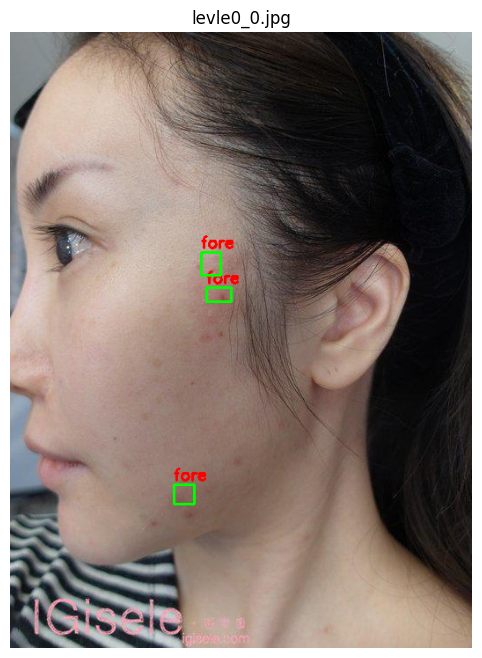

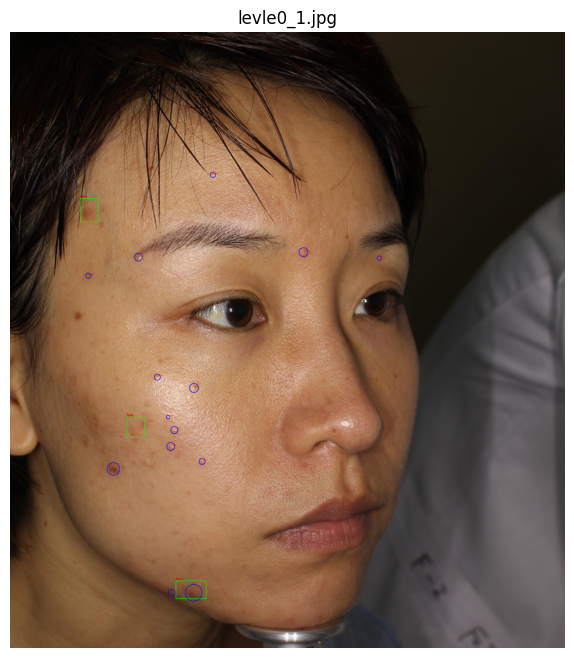

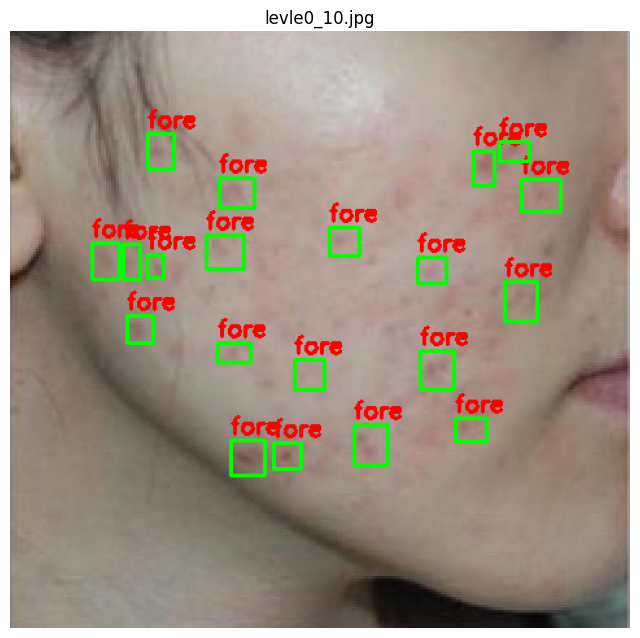

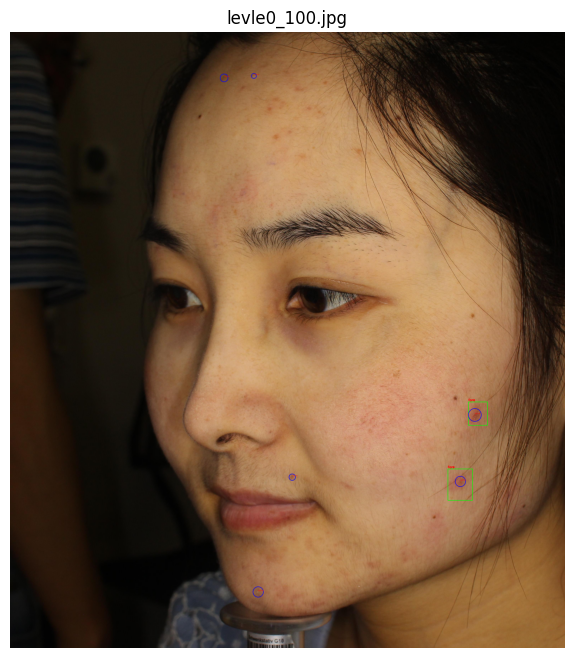

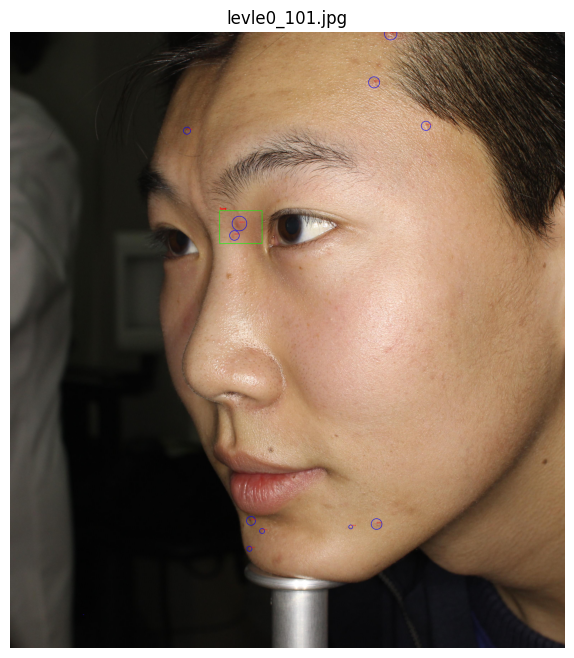

In [14]:

import matplotlib.pyplot as plt
import xmltodict
import json
from pathlib import Path
import xml.etree.ElementTree as ET
from tqdm import tqdm 
import cv2
import shutil
import random
import numpy as np
import albumentations as A

image_dir = Path("Classification/JPEGImages")          # chứa ảnh gốc
anno_dir = Path("Detection/VOC2007/Annotations")       # chứa file XML (bounding box)
json_path = Path("Acne04-v2_annotations.json")         # chứa label dạng circle

# 🧾 Đọc file JSON của Acne04-v2
with open(json_path, 'r') as f:
    json_data = json.load(f)

# Tạo dict map từ image_id -> list các circle annotations
circle_dict = {}
for ann in json_data["annotations"]:
    img_id = ann["image_id"]
    circle_dict.setdefault(img_id, []).append(ann)

# Map từ image file name -> id
imgid_from_filename = {img["file_name"]: img["id"] for img in json_data["images"]}

# 🧾 Lấy danh sách file XML
xml_files = sorted(list(anno_dir.glob("*.xml")))


# 🔍 Hàm hiển thị annotation cả 2 loại
def visualize_annotation(xml_path):
    with open(xml_path) as f:
        anno = xmltodict.parse(f.read())["annotation"]
    
    img_name = anno["filename"]
    img_path = image_dir / img_name

    # Đọc ảnh
    img = cv2.imread(str(img_path))
    if img is None:
        print(f"⚠️ Không tìm thấy ảnh: {img_path}")
        return
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # --- 🟩 Vẽ bounding boxes từ file XML ---
    objects = anno.get("object", [])
    if not isinstance(objects, list):
        objects = [objects]

    for obj in objects:
        name = obj["name"]
        box = obj["bndbox"]
        x1, y1, x2, y2 = map(int, [box["xmin"], box["ymin"], box["xmax"], box["ymax"]])
        cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(img, name, (x1, y1 - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

    # --- 🔵 Vẽ circle từ Acne04-v2_annotations.json ---
    if img_name in imgid_from_filename:
        img_id = imgid_from_filename[img_name]
        if img_id in circle_dict:
            for ann in circle_dict[img_id]:
                center = tuple(map(int, ann["coordinates"]))   # 🔁 sửa từ 'center' → 'coordinates'
                radius = int(ann["radius"])
                cv2.circle(img, center, radius, (0, 0, 255), 2)  # vòng tròn đỏ
                cv2.putText(img, ann["class_name"], (center[0], center[1] - 5),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.4, (255, 0, 0), 1)

    # Hiển thị ảnh
    plt.figure(figsize=(8, 8))
    plt.imshow(img)
    plt.title(img_name)
    plt.axis("off")
    plt.show()


# 🖼️ Hiển thị thử 5 ảnh đầu tiên
for xml in xml_files[:5]:
    visualize_annotation(xml)


In [ ]:
json_path = Path("Acne04-v2_annotations.json")      # file gốc chứa circle
output_dir = Path("Converted_XML")                  # thư mục xuất file XML mới
output_dir.mkdir(parents=True, exist_ok=True)

# 🧾 Đọc JSON
with open(json_path, 'r') as f:
    data = json.load(f)

images = {img["id"]: img for img in data["images"]}
annotations = data["annotations"]

# 🧱 Hàm tạo cấu trúc XML VOC
def create_voc_xml(img_info, ann_list, output_path):
    # Gốc
    annotation = ET.Element("annotation")

    # Thông tin ảnh
    ET.SubElement(annotation, "folder").text = "Converted"
    ET.SubElement(annotation, "filename").text = img_info["file_name"]
    size = ET.SubElement(annotation, "size")
    ET.SubElement(size, "width").text = str(img_info["width"])
    ET.SubElement(size, "height").text = str(img_info["height"])
    ET.SubElement(size, "depth").text = "3"

    # Thêm từng object
    for ann in ann_list:
        obj = ET.SubElement(annotation, "object")
        ET.SubElement(obj, "name").text = ann["class_name"]
        ET.SubElement(obj, "pose").text = "Unspecified"
        ET.SubElement(obj, "truncated").text = "0"
        ET.SubElement(obj, "difficult").text = "0"

        bbox = ET.SubElement(obj, "bndbox")
        x, y = ann["coordinates"]
        r = ann["radius"]
        xmin, ymin = max(0, x - r), max(0, y - r)
        xmax, ymax = x + r, y + r
        ET.SubElement(bbox, "xmin").text = str(int(xmin))
        ET.SubElement(bbox, "ymin").text = str(int(ymin))
        ET.SubElement(bbox, "xmax").text = str(int(xmax))
        ET.SubElement(bbox, "ymax").text = str(int(ymax))

    # Ghi file
    tree = ET.ElementTree(annotation)
    tree.write(output_path, encoding="utf-8", xml_declaration=True)


# 🛠️ Gom annotation theo image_id
ann_per_image = {}
for ann in annotations:
    ann_per_image.setdefault(ann["image_id"], []).append(ann)

# 🔁 Chuyển tất cả ảnh
for img_id, img_info in tqdm(images.items(), desc="Converting to VOC XML"):
    anns = ann_per_image.get(img_id, [])
    if not anns:
        continue
    xml_out = output_dir / f"{Path(img_info['file_name']).stem}.xml"
    create_voc_xml(img_info, anns, xml_out)

print(f"✅ Đã tạo {len(list(output_dir.glob('*.xml')))} file XML trong thư mục '{output_dir}'")


Converting to VOC XML: 100%|██████████| 1204/1204 [00:00<00:00, 1388.18it/s]

✅ Đã tạo 1204 file XML trong thư mục 'Converted_XML'


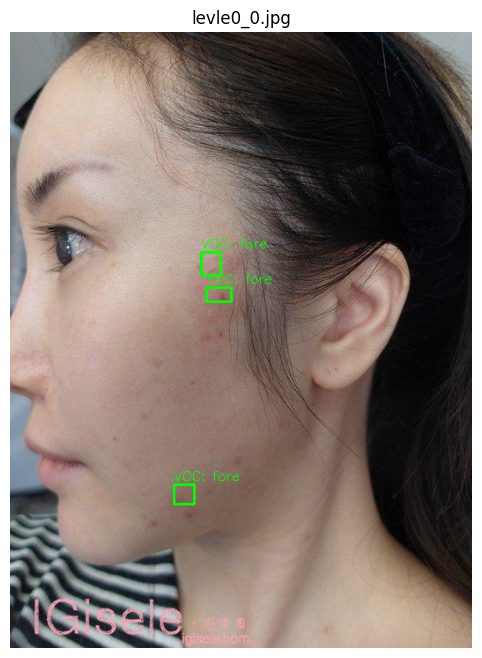

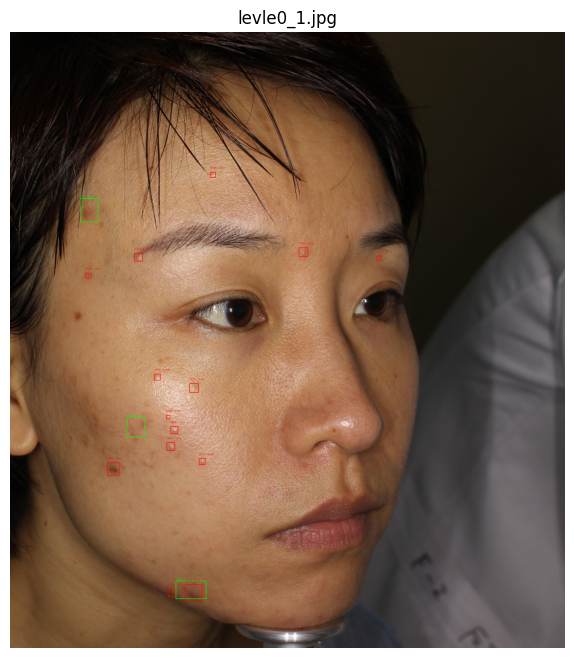

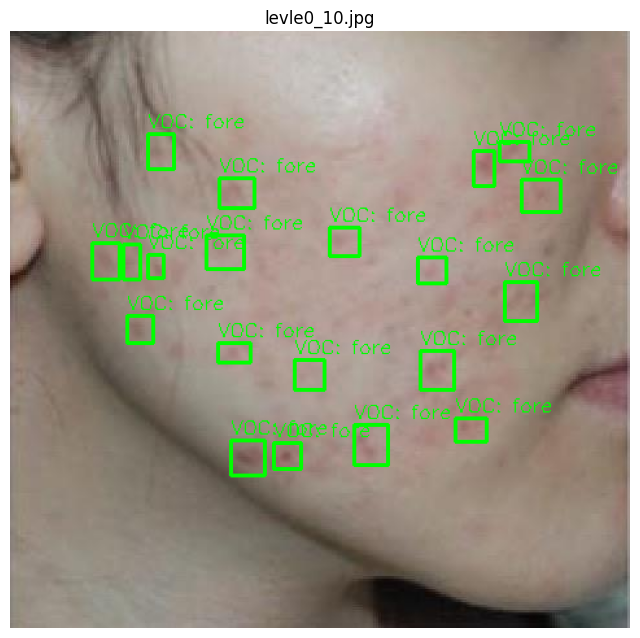

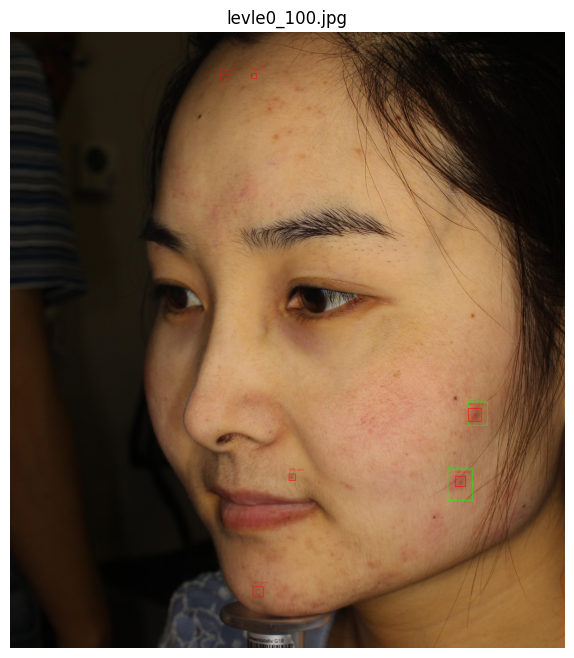

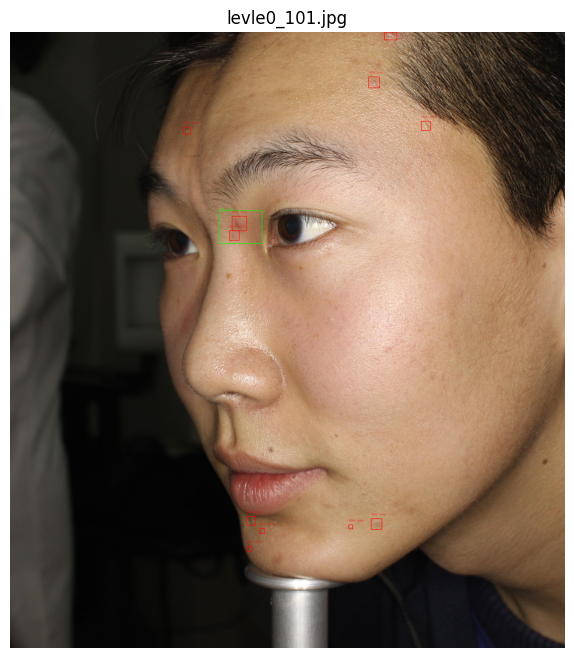

In [ ]:
image_dir = Path("Classification/JPEGImages")
voc_dir = Path("Detection/VOC2007/Annotations")   # bounding box gốc
converted_dir = Path("Converted_XML")             

# 🧾 Lấy danh sách file XML (VOC)
voc_files = sorted(list(voc_dir.glob("*.xml")))

# 🔍 Hàm đọc file XML và lấy danh sách bounding box
def read_boxes(xml_path):
    boxes = []
    if not xml_path.exists():
        return boxes
    with open(xml_path, 'r') as f:
        anno = xmltodict.parse(f.read()).get("annotation", {})
    objects = anno.get("object", [])
    if not isinstance(objects, list):
        objects = [objects]
    for obj in objects:
        try:
            name = obj["name"]
            box = obj["bndbox"]
            x1, y1, x2, y2 = map(int, [box["xmin"], box["ymin"], box["xmax"], box["ymax"]])
            boxes.append((name, x1, y1, x2, y2))
        except:
            continue
    return boxes

# 🧩 Hàm hiển thị ảnh với cả 2 loại bounding box
def visualize_two_annotations(img_name):
    img_path = image_dir / img_name
    img = cv2.imread(str(img_path))
    if img is None:
        print(f"⚠️ Không tìm thấy ảnh: {img_path}")
        return
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    voc_path = voc_dir / f"{Path(img_name).stem}.xml"
    conv_path = converted_dir / f"{Path(img_name).stem}.xml"

    # 🟩 Vẽ box gốc (VOC2007)
    for name, x1, y1, x2, y2 in read_boxes(voc_path):
        cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(img, f"VOC: {name}", (x1, y1 - 5),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

    # 🟦 Vẽ box mới (Converted)
    for name, x1, y1, x2, y2 in read_boxes(conv_path):
        cv2.rectangle(img, (x1, y1), (x2, y2), (255, 0, 0), 2)
        cv2.putText(img, f"NEW: {name}", (x1, y1 - 20),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)

    # Hiển thị ảnh
    plt.figure(figsize=(8, 8))
    plt.imshow(img)
    plt.title(img_name)
    plt.axis("off")
    plt.show()


# 🖼️ Hiển thị thử 5 ảnh đầu tiên (dựa theo file XML gốc)
for xml in voc_files[:5]:
    img_name = xml.stem + ".jpg"
    visualize_two_annotations(img_name)


In [ ]:
voc_dir = Path("Detection/VOC2007/Annotations")   # nhãn cũ
converted_dir = Path("Converted_XML")              # nhãn mới
merged_dir = Path("Merged_XML")                    # kết quả
merged_dir.mkdir(exist_ok=True)

# --- Hàm đọc bounding boxes ---
def read_boxes(xml_path):
    boxes = []
    if not xml_path.exists():
        return boxes
    with open(xml_path, 'r') as f:
        anno = xmltodict.parse(f.read()).get("annotation", {})
    objects = anno.get("object", [])
    if not isinstance(objects, list):
        objects = [objects]
    for obj in objects:
        try:
            name = obj["name"]
            box = obj["bndbox"]
            x1, y1, x2, y2 = map(float, [box["xmin"], box["ymin"], box["xmax"], box["ymax"]])
            boxes.append((name, x1, y1, x2, y2))
        except:
            continue
    return boxes

# --- Hàm tính IoU ---
def iou(boxA, boxB):
    xA = max(boxA[1], boxB[1])
    yA = max(boxA[2], boxB[2])
    xB = min(boxA[3], boxB[3])
    yB = min(boxA[4], boxB[4])
    inter = max(0, xB - xA) * max(0, yB - yA)
    areaA = (boxA[3] - boxA[1]) * (boxA[4] - boxA[2])
    areaB = (boxB[3] - boxB[1]) * (boxB[4] - boxB[2])
    return inter / (areaA + areaB - inter + 1e-6)

# --- Kiểm tra box cũ có bao trùm box mới không ---
def is_containing(outer, inner, ratio_threshold=0.8):
    _, x1o, y1o, x2o, y2o = outer
    _, x1i, y1i, x2i, y2i = inner
    if x1i >= x1o and y1i >= y1o and x2i <= x2o and y2i <= y2o:
        area_inner = (x2i - x1i) * (y2i - y1i)
        area_outer = (x2o - x1o) * (y2o - y1o)
        return (area_inner / area_outer) < ratio_threshold  # outer gấp nhiều lần inner
    return False

# --- Hàm ghi XML sạch ---
def write_clean_xml(base_xml, boxes, save_path):
    with open(base_xml, 'r') as f:
        anno = xmltodict.parse(f.read())["annotation"]

    new_anno = {
        "annotation": {
            "folder": anno.get("folder", "Merged"),
            "filename": anno["filename"],
            "path": anno.get("path", anno["filename"]),
            "size": anno["size"],
            "segmented": "0",
            "object": []
        }
    }

    for name, x1, y1, x2, y2 in boxes:
        new_anno["annotation"]["object"].append({
            "name": name,
            "pose": "Unspecified",
            "truncated": "0",
            "difficult": "0",
            "bndbox": {
                "xmin": str(int(x1)),
                "ymin": str(int(y1)),
                "xmax": str(int(x2)),
                "ymax": str(int(y2))
            }
        })

    with open(save_path, "w") as f:
        f.write(xmltodict.unparse(new_anno, pretty=True))

# --- Gộp ---
for voc_xml in sorted(voc_dir.glob("*.xml")):
    fname = voc_xml.name
    conv_xml = converted_dir / fname
    merged_xml = merged_dir / fname

    voc_boxes = read_boxes(voc_xml)
    conv_boxes = read_boxes(conv_xml)

    final_boxes = conv_boxes.copy()  # ưu tiên giữ box mới

    # Chỉ thêm box cũ nếu KHÔNG trùng và KHÔNG bao trùm box mới
    for voc_box in voc_boxes:
        overlapped = False
        for conv_box in conv_boxes:
            if iou(voc_box, conv_box) > 0.2 or is_containing(voc_box, conv_box):
                overlapped = True
                break
        if not overlapped:
            final_boxes.append(voc_box)

    # Ghi ra file kết quả sạch
    base_xml = conv_xml if conv_xml.exists() else voc_xml
    write_clean_xml(base_xml, final_boxes, merged_xml)

print("✅ Đã gộp xong — ưu tiên bounding box mới, loại bỏ box cũ sai hoặc bao trùm.")
print("📁 File kết quả lưu tại: Merged_XML/")


✅ Đã gộp xong — ưu tiên bounding box mới, loại bỏ box cũ sai hoặc bao trùm.
📁 File kết quả lưu tại: Merged_XML/


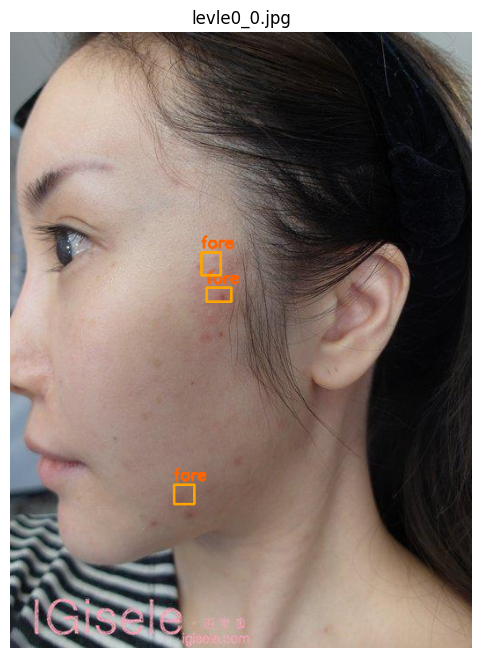

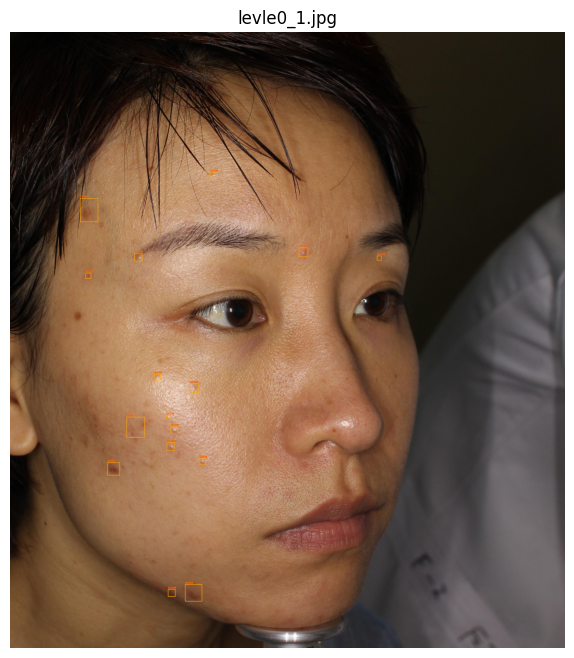

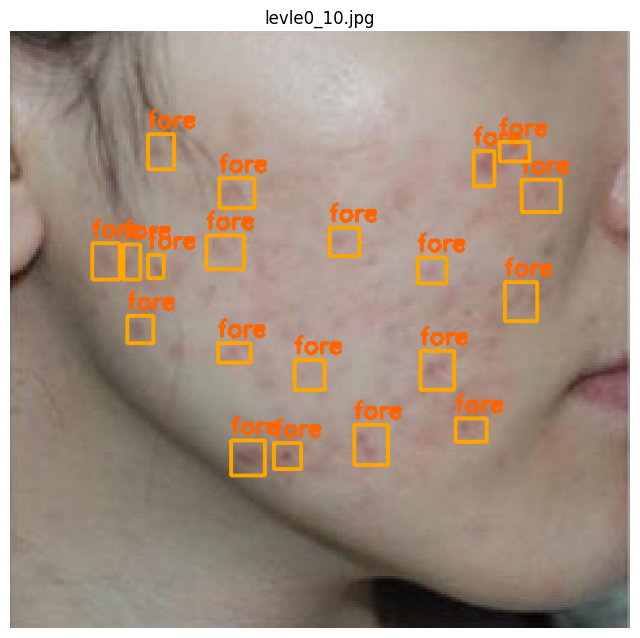

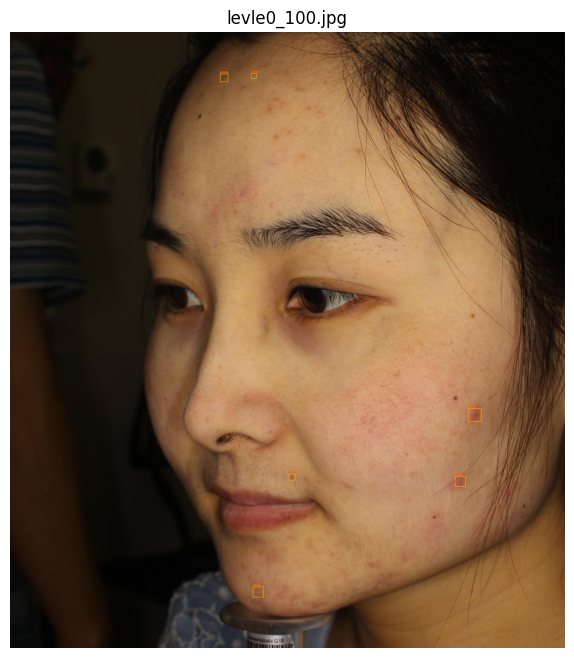

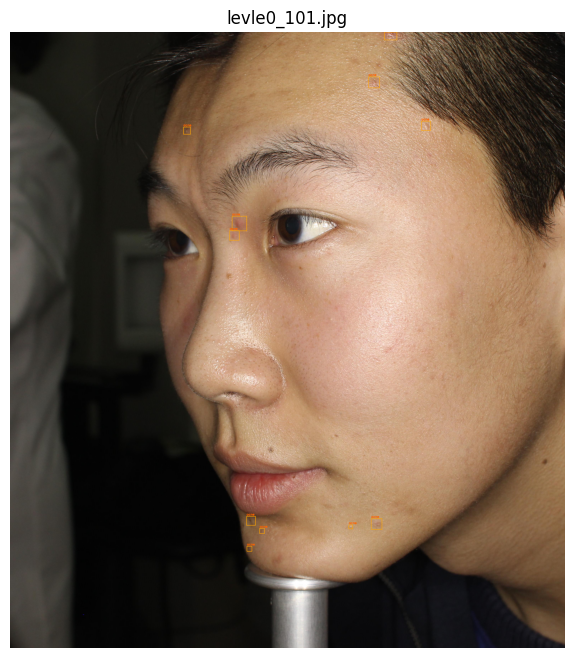

In [ ]:

image_dir = Path("Classification/JPEGImages")  # ảnh gốc
merged_dir = Path("Merged_XML")                # nhãn đã gộp

# 🧾 Lấy danh sách file XML
xml_files = sorted(list(merged_dir.glob("*.xml")))

# --- Hàm đọc box từ XML ---
def read_boxes(xml_path):
    boxes = []
    with open(xml_path, 'r') as f:
        anno = xmltodict.parse(f.read()).get("annotation", {})
    objects = anno.get("object", [])
    if not isinstance(objects, list):
        objects = [objects]
    for obj in objects:
        try:
            name = obj["name"]
            box = obj["bndbox"]
            x1, y1, x2, y2 = map(int, [box["xmin"], box["ymin"], box["xmax"], box["ymax"]])
            boxes.append((name, x1, y1, x2, y2))
        except:
            continue
    return boxes

# --- Hàm hiển thị ảnh ---
def visualize_merged(img_name):
    img_path = image_dir / img_name
    xml_path = merged_dir / f"{Path(img_name).stem}.xml"

    img = cv2.imread(str(img_path))
    if img is None:
        print(f"⚠️ Không tìm thấy ảnh: {img_path}")
        return
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # 🟧 Vẽ bounding boxes từ merged xml
    for name, x1, y1, x2, y2 in read_boxes(xml_path):
        cv2.rectangle(img, (x1, y1), (x2, y2), (255, 165, 0), 2)  # màu cam
        cv2.putText(img, name, (x1, y1 - 5),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 100, 0), 2)

    # Hiển thị ảnh
    plt.figure(figsize=(8, 8))
    plt.imshow(img)
    plt.title(img_name)
    plt.axis("off")
    plt.show()

# 🖼️ Hiển thị 5 ảnh đầu tiên
for xml in xml_files[:5]:
    img_name = xml.stem + ".jpg"
    visualize_merged(img_name)


In [1]:
from pathlib import Path
import xmltodict
from tqdm import tqdm
import cv2

# --- Đường dẫn ---
image_dir = Path("Classification/JPEGImages")
merged_dir = Path("Merged_XML")

# --- Danh sách file ---
xml_files = sorted(list(merged_dir.glob("*.xml")))
img_files = sorted(list(image_dir.glob("*.jpg")))

print(f"Tổng số file XML: {len(xml_files)}")
print(f"Tổng số file ảnh JPG: {len(img_files)}")

# --- Tạo set tên file (không đuôi) ---
xml_stems = set(f.stem for f in xml_files)
img_stems = set(f.stem for f in img_files)

# 🧩 1. Kiểm tra ảnh thiếu XML
missing_xml = img_stems - xml_stems
if missing_xml:
    print(f"⚠️ Ảnh bị thiếu XML: {len(missing_xml)}")
    for name in list(missing_xml)[:10]:
        print("  -", name + ".jpg")
else:
    print("✅ Không có ảnh nào bị thiếu XML")

# 🧩 2. Kiểm tra XML thiếu ảnh
missing_img = xml_stems - img_stems
if missing_img:
    print(f"⚠️ XML bị thiếu ảnh: {len(missing_img)}")
    for name in list(missing_img)[:10]:
        print("  -", name + ".xml")
else:
    print("✅ Không có XML nào bị thiếu ảnh")

# 🧩 3. Kiểm tra XML trống (không có object)
empty_xml = []
all_labels = set()
for xml_path in tqdm(xml_files, desc="Đang đọc nhãn"):
    with open(xml_path, 'r') as f:
        anno = xmltodict.parse(f.read()).get("annotation", {})
    objs = anno.get("object", [])
    if not objs:
        empty_xml.append(xml_path.stem)
    else:
        if not isinstance(objs, list):
            objs = [objs]
        for o in objs:
            label = o.get("name", "").strip()
            if label:
                all_labels.add(label)

if empty_xml:
    print(f"⚠️ XML không có nhãn: {len(empty_xml)}")
    for name in list(empty_xml)[:10]:
        print("  -", name + ".xml")
else:
    print("✅ Không có XML nào trống nhãn")

# 🧩 4. Thống kê nhãn
print(f"\nTổng số loại nhãn khác nhau: {len(all_labels)}")
print("Danh sách nhãn:")
for label in sorted(all_labels):
    print(" -", label)


Tổng số file XML: 1457
Tổng số file ảnh JPG: 1457
✅ Không có ảnh nào bị thiếu XML
✅ Không có XML nào bị thiếu ảnh


Đang đọc nhãn: 100%|██████████| 1457/1457 [00:15<00:00, 96.25it/s] 

✅ Không có XML nào trống nhãn

Tổng số loại nhãn khác nhau: 1
Danh sách nhãn:
 - acne


In [7]:

import cv2, xmltodict, shutil, random
import numpy as np
from pathlib import Path
from tqdm import tqdm
import albumentations as A

# ------------------------- Đường dẫn -------------------------
img_dir = Path("Classification/JPEGImages")
anno_dir = Path("Last\Predicted_XML")
save_img_dir = Path("Augmented/JPEGImages")
save_anno_dir = Path("Augmented/Annotations")
save_img_dir.mkdir(parents=True, exist_ok=True)
save_anno_dir.mkdir(parents=True, exist_ok=True)

# ------------------------- Hàm đọc bounding box -------------------------
def read_boxes(xml_path):
    with open(xml_path, 'r') as f:
        anno = xmltodict.parse(f.read())["annotation"]
    boxes, labels = [], []
    objects = anno.get("object", [])
    if not isinstance(objects, list):
        objects = [objects]
    for obj in objects:
        box = obj["bndbox"]
        x1, y1, x2, y2 = map(float, [box["xmin"], box["ymin"], box["xmax"], box["ymax"]])
        boxes.append([x1, y1, x2, y2])
        labels.append(obj["name"])
    return boxes, labels

# ------------------------- Hàm ghi XML -------------------------
def write_xml(img_name, boxes, labels, img_shape, save_path):
    h, w, c = img_shape
    anno = {
        "annotation": {
            "folder": "Augmented",
            "filename": img_name,
            "path": img_name,
            "size": {"width": str(w), "height": str(h), "depth": str(c)},
            "segmented": "0",
            "object": []
        }
    }
    for label, (x1, y1, x2, y2) in zip(labels, boxes):
        anno["annotation"]["object"].append({
            "name": label,
            "pose": "Unspecified",
            "truncated": "0",
            "difficult": "0",
            "bndbox": {
                "xmin": str(int(x1)),
                "ymin": str(int(y1)),
                "xmax": str(int(x2)),
                "ymax": str(int(y2))
            }
        })
    with open(save_path, "w") as f:
        f.write(xmltodict.unparse(anno, pretty=True))

# ------------------------- Lọc bounding box nhỏ -------------------------
def filter_small_boxes(boxes, labels, min_size=1):
    new_boxes, new_labels = [], []
    for box, label in zip(boxes, labels):
        x1, y1, x2, y2 = box
        if (x2-x1) >= min_size and (y2-y1) >= min_size:
            new_boxes.append(box)
            new_labels.append(label)
    return new_boxes, new_labels

# ------------------------- Augmentation cơ bản -------------------------
base_transform = A.Compose([
    A.Resize(512, 512),
    A.OneOf([
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.2),
        A.RandomRotate90(p=0.5),
        A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.2, rotate_limit=20, border_mode=cv2.BORDER_REFLECT_101, p=0.5)
    ], p=0.8),
    A.OneOf([
        A.RandomBrightnessContrast(brightness_limit=0.3, contrast_limit=0.3, p=0.5),
        A.HueSaturationValue(hue_shift_limit=15, sat_shift_limit=20, val_shift_limit=15, p=0.5),
        A.RandomGamma(gamma_limit=(80, 120), p=0.5)
    ], p=0.8),
    A.OneOf([
        A.GaussianBlur(blur_limit=(3,5), p=0.5),
        A.MotionBlur(blur_limit=(3,5), p=0.3),
        A.ImageCompression(quality=80, p=0.5)
    ], p=0.6),
    A.OneOf([
        A.CLAHE(p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.RGBShift(r_shift_limit=10, g_shift_limit=10, b_shift_limit=10, p=0.5)
    ], p=0.5)
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['class_labels'], min_visibility=0.3))

# ------------------------- Crop ngẫu nhiên -------------------------
def random_crop(img, boxes, labels, crop_size=(256, 256)):
    h, w = img.shape[:2]
    ch, cw = crop_size
    if w <= cw or h <= ch:
        return img, boxes, labels
    x0 = random.randint(0, w - cw)
    y0 = random.randint(0, h - ch)
    x1 = x0 + cw
    y1 = y0 + ch
    cropped_img = img[y0:y1, x0:x1]
    new_boxes, new_labels = [], []
    for box, label in zip(boxes, labels):
        bx1, by1, bx2, by2 = box
        if bx2 < x0 or bx1 > x1 or by2 < y0 or by1 > y1:
            continue
        nx1 = max(bx1 - x0, 0)
        ny1 = max(by1 - y0, 0)
        nx2 = min(bx2 - x0, cw)
        ny2 = min(by2 - y0, ch)
        new_boxes.append([nx1, ny1, nx2, ny2])
        new_labels.append(label)
    return cropped_img, new_boxes, new_labels

# ------------------------- Mosaic -------------------------
def mosaic(images_boxes_labels, out_size=(512, 512)):
    h, w = out_size
    mosaic_img = np.zeros((h, w, 3), dtype=np.uint8)
    final_boxes, final_labels = [], []
    positions = [(0,0), (0,w//2), (h//2,0), (h//2,w//2)]
    for (img, boxes, labels), (y0, x0) in zip(images_boxes_labels, positions):
        img_resized = cv2.resize(img, (w//2, h//2))
        mosaic_img[y0:y0+h//2, x0:x0+w//2] = img_resized
        scale_x = (w/2)/img.shape[1]
        scale_y = (h/2)/img.shape[0]
        for box, label in zip(boxes, labels):
            bx1, by1, bx2, by2 = box
            bx1 = bx1*scale_x + x0
            by1 = by1*scale_y + y0
            bx2 = bx2*scale_x + x0
            by2 = by2*scale_y + y0
            final_boxes.append([bx1, by1, bx2, by2])
            final_labels.append(label)
    return mosaic_img, final_boxes, final_labels

# ------------------------- Copy ảnh gốc -------------------------
xml_files = sorted(list(anno_dir.glob("*.xml")))
for xml_path in tqdm(xml_files, desc="Copy original images"):
    img_name = xml_path.stem + ".jpg"
    img_path = img_dir / img_name
    if img_path.exists():
        shutil.copy(str(img_path), str(save_img_dir / img_name))
        shutil.copy(str(xml_path), str(save_anno_dir / xml_path.name))

# ------------------------- Tăng cường dữ liệu -------------------------
num_crops = 4        # số crop/ảnh gốc
num_versions = 4     # số biến thể augment mỗi crop
num_mosaic = 2       # số mosaic khác nhau mỗi ảnh

for xml_path in tqdm(xml_files, desc="Augmenting images"):
    img_name = xml_path.stem + ".jpg"
    img_path = img_dir / img_name
    if not img_path.exists():
        continue
    img = cv2.imread(str(img_path))
    if img is None:
        continue
    boxes, labels = read_boxes(xml_path)
    
    # Tạo crops
    crops = []
    for i in range(num_crops):
        crop_img, crop_boxes, crop_labels = random_crop(img, boxes, labels, crop_size=(256,256))
        crop_boxes, crop_labels = filter_small_boxes(crop_boxes, crop_labels, min_size=5)
        if len(crop_boxes) == 0:
            continue
        for j in range(num_versions):
            trans = base_transform(image=crop_img, bboxes=crop_boxes, class_labels=crop_labels)
            final_img = trans['image']
            final_boxes = trans['bboxes']
            final_labels = trans['class_labels']
            crop_name = f"{xml_path.stem}_crop{i+1}_v{j+1}.jpg"
            cv2.imwrite(str(save_img_dir / crop_name), final_img)
            write_xml(crop_name.replace(".jpg",".xml"), final_boxes, final_labels, final_img.shape,
                      save_anno_dir / crop_name.replace(".jpg",".xml"))
            crops.append((final_img, final_boxes, final_labels))
    
    # Tạo mosaic nhiều lần
    for m in range(num_mosaic):
        if len(crops) < 4:
            continue
        selected = random.sample(crops, 4)
        mosaic_img, mosaic_boxes, mosaic_labels = mosaic(selected)
        mosaic_name = f"{xml_path.stem}_mosaic{m+1}.jpg"
        cv2.imwrite(str(save_img_dir / mosaic_name), mosaic_img)
        write_xml(mosaic_name.replace(".jpg",".xml"), mosaic_boxes, mosaic_labels, mosaic_img.shape,
                  save_anno_dir / mosaic_name.replace(".jpg",".xml"))

print("✅ Hoàn tất pipeline tăng cường dữ liệu.")
print(f"📁 Ảnh lưu tại: {save_img_dir}")
print(f"📁 Nhãn lưu tại: {save_anno_dir}")


c:\Users\Phong\Downloads\Data\.venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
c:\Users\Phong\Downloads\Data\.venv\lib\site-packages\albumentations\core\validation.py:114: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)
C:\Users\Phong\AppData\Local\Temp\ipykernel_20144\695354684.py:86: UserWarning: Argument(s) 'quality' are not valid for transform ImageCompression
  A.ImageCompression(quality=80, p=0.5)
Augmenting images: 100%|██████████| 1457/1457 [01:25<00:00, 17.10it/s]

✅ Hoàn tất pipeline tăng cường dữ liệu.
📁 Ảnh lưu tại: Augmented\JPEGImages
📁 Nhãn lưu tại: Augmented\Annotations


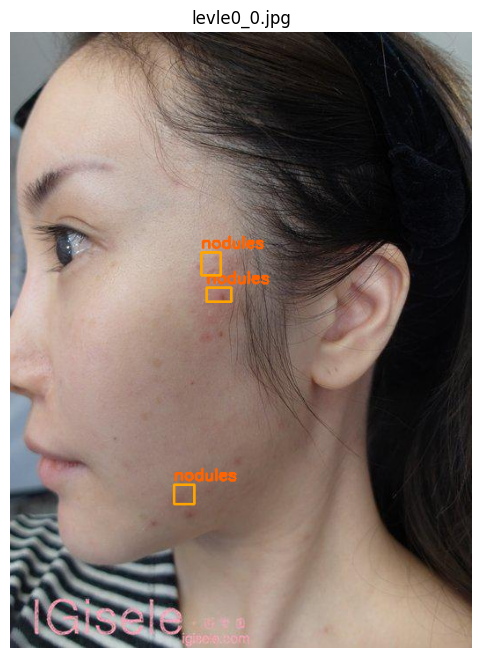

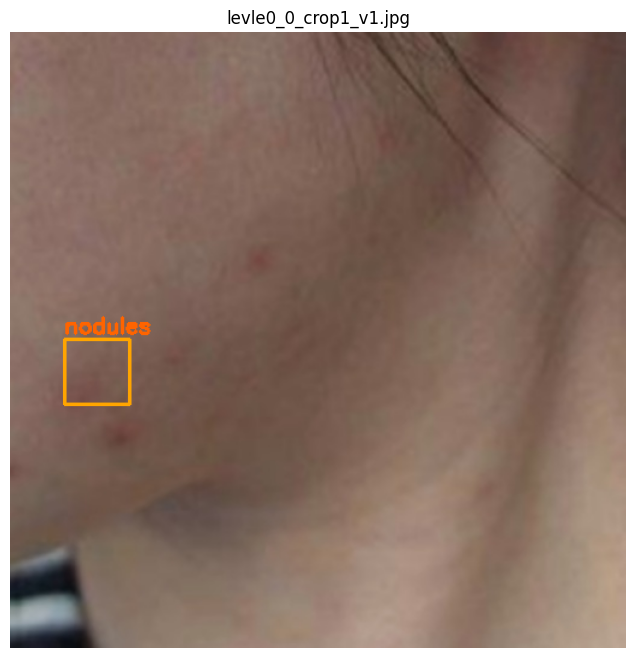

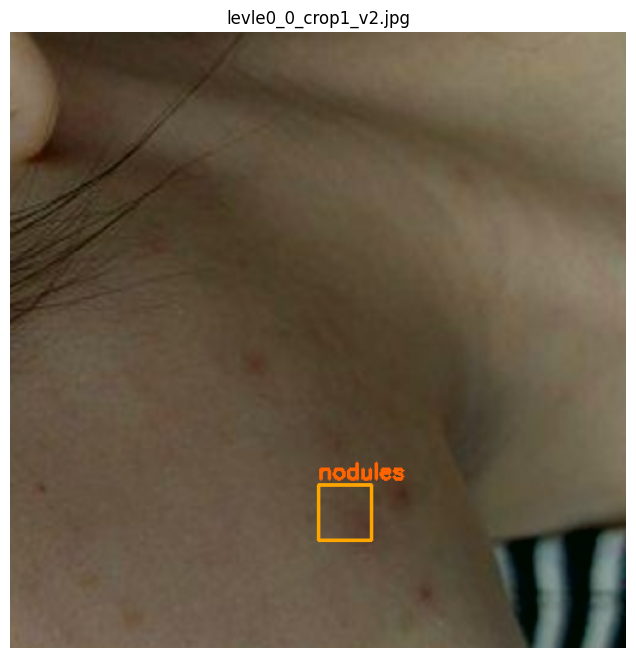

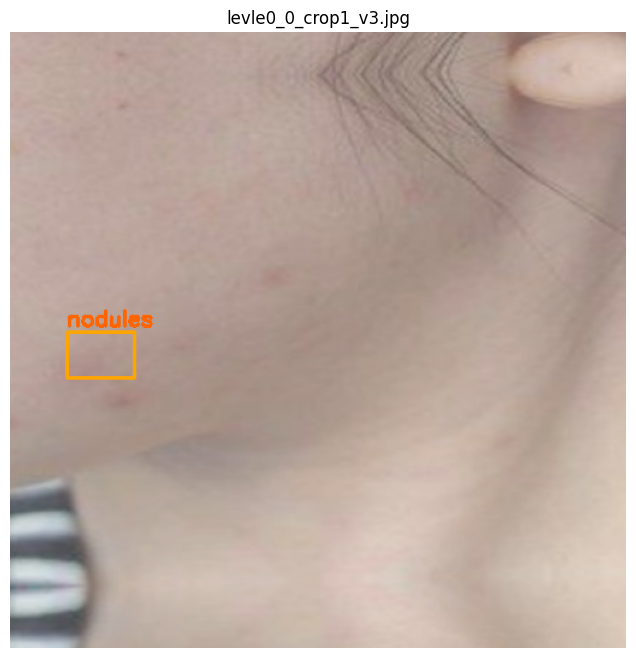

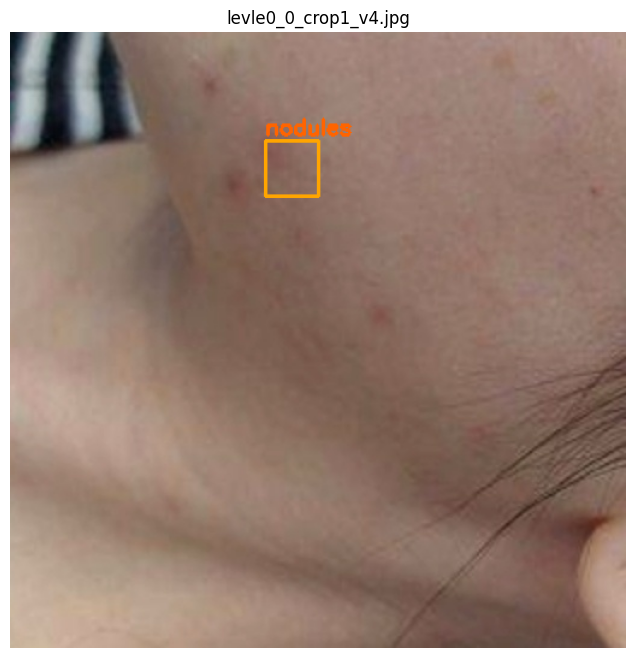

...

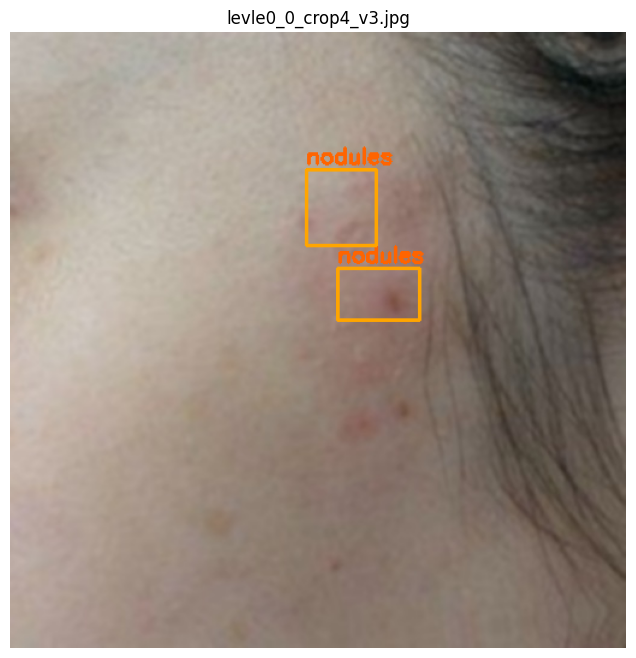

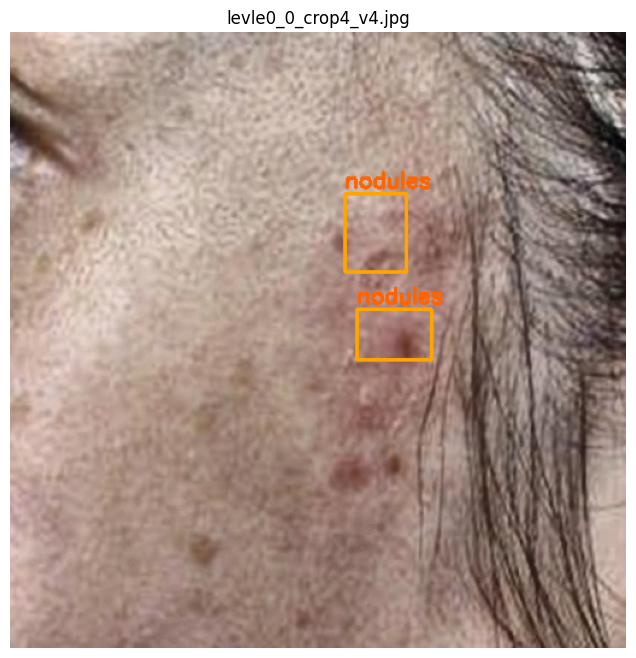

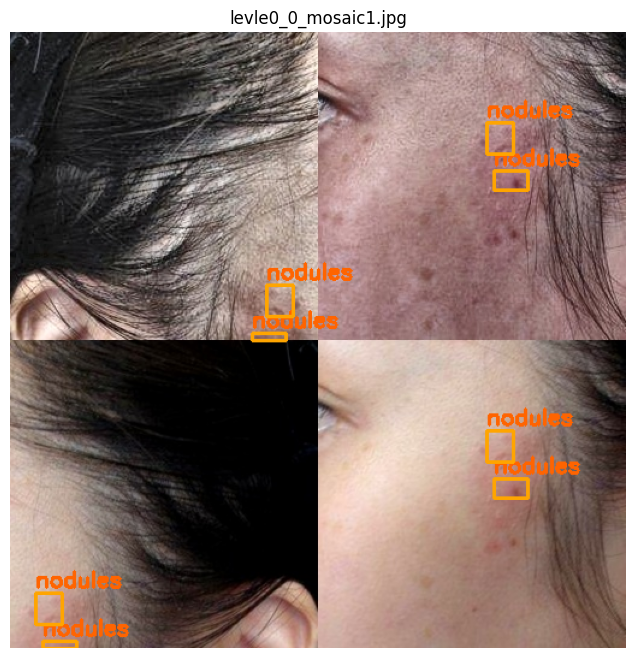

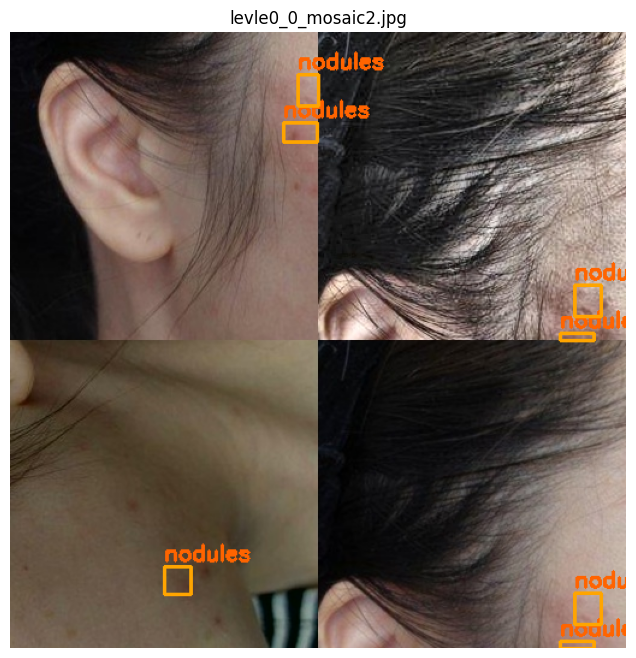

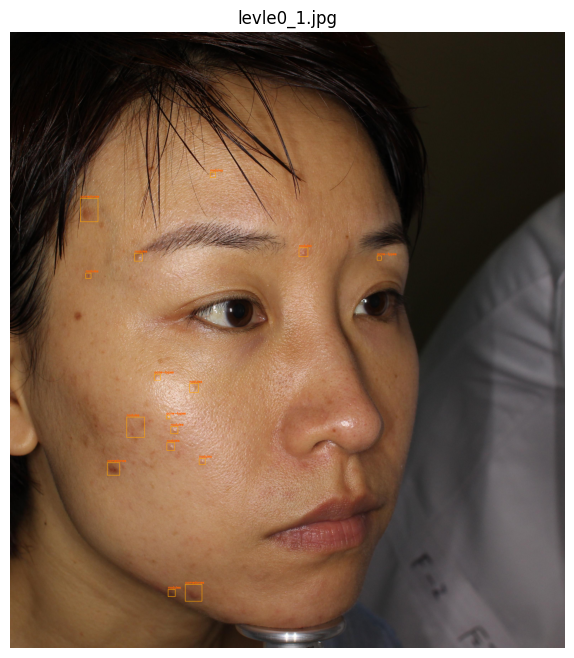

In [8]:

image_dir = Path("Augmented/JPEGImages")  # ảnh gốc
merged_dir = Path("Augmented/Annotations")                # nhãn đã gộp

# 🧾 Lấy danh sách file XML
xml_files = sorted(list(merged_dir.glob("*.xml")))

# --- Hàm đọc box từ XML ---
def read_boxes(xml_path):
    boxes = []
    with open(xml_path, 'r') as f:
        anno = xmltodict.parse(f.read()).get("annotation", {})
    objects = anno.get("object", [])
    if not isinstance(objects, list):
        objects = [objects]
    for obj in objects:
        try:
            name = obj["name"]
            box = obj["bndbox"]
            x1, y1, x2, y2 = map(int, [box["xmin"], box["ymin"], box["xmax"], box["ymax"]])
            boxes.append((name, x1, y1, x2, y2))
        except:
            continue
    return boxes

# --- Hàm hiển thị ảnh ---
def visualize_merged(img_name):
    img_path = image_dir / img_name
    xml_path = merged_dir / f"{Path(img_name).stem}.xml"

    img = cv2.imread(str(img_path))
    if img is None:
        print(f"⚠️ Không tìm thấy ảnh: {img_path}")
        return
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # 🟧 Vẽ bounding boxes từ merged xml
    for name, x1, y1, x2, y2 in read_boxes(xml_path):
        cv2.rectangle(img, (x1, y1), (x2, y2), (255, 165, 0), 2)  # màu cam
        cv2.putText(img, name, (x1, y1 - 5),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 100, 0), 2)

    # Hiển thị ảnh
    plt.figure(figsize=(8, 8))
    plt.imshow(img)
    plt.title(img_name)
    plt.axis("off")
    plt.show()

# 🖼️ Hiển thị 5 ảnh đầu tiên
for xml in xml_files[:20]:
    img_name = xml.stem + ".jpg"
    visualize_merged(img_name)


In [10]:
import json
import xmltodict
from pathlib import Path
import shutil

# --- Thư mục ---
anno_dir = Path("Augmented/Annotations")   # XML gốc hoặc merged
image_dir = Path("Augmented/JPEGImages")  # ảnh gốc/augment
save_img_dir = Path("COCO_Images")        # thư mục copy ảnh sang
save_img_dir.mkdir(parents=True, exist_ok=True)

save_json_path = Path("coco_dataset.json")  # file JSON mới

# --- Lấy danh sách file XML ---
xml_files = sorted(list(anno_dir.glob("*.xml")))

# --- Tạo danh sách category ---
categories_set = set()
for xml_path in xml_files:
    with open(xml_path) as f:
        anno = xmltodict.parse(f.read())["annotation"]
    objects = anno.get("object", [])
    if not isinstance(objects, list):
        objects = [objects]
    for obj in objects:
        categories_set.add(obj["name"])

# Map tên category -> id
categories_list = [{"id": i+1, "name": name} for i, name in enumerate(sorted(categories_set))]
category_name_to_id = {c['name']: c['id'] for c in categories_list}

# --- Chuyển XML sang COCO ---
images = []
annotations = []
ann_id = 1
for img_id, xml_path in enumerate(xml_files, 1):
    img_name = xml_path.stem + ".jpg"
    img_path = image_dir / img_name

    # Copy ảnh sang thư mục mới
    if img_path.exists():
        shutil.copy(str(img_path), str(save_img_dir / img_name))
    else:
        print(f"⚠️ Không tìm thấy ảnh: {img_path}")
        continue

    with open(xml_path) as f:
        anno = xmltodict.parse(f.read())["annotation"]

    # Thông tin ảnh
    width = int(anno["size"]["width"])
    height = int(anno["size"]["height"])
    images.append({
        "id": img_id,
        "file_name": img_name,
        "width": width,
        "height": height
    })

    # Thông tin annotation
    objects = anno.get("object", [])
    if not isinstance(objects, list):
        objects = [objects]
    for obj in objects:
        box = obj["bndbox"]
        x_min = float(box["xmin"])
        y_min = float(box["ymin"])
        x_max = float(box["xmax"])
        y_max = float(box["ymax"])
        width_box = x_max - x_min
        height_box = y_max - y_min

        # Loại bỏ bounding box quá nhỏ
        if width_box < 1 or height_box < 1:
            continue

        annotations.append({
            "id": ann_id,
            "image_id": img_id,
            "category_id": category_name_to_id[obj["name"]],
            "bbox": [x_min, y_min, width_box, height_box],
            "area": width_box * height_box,
            "iscrowd": 0
        })
        ann_id += 1

# --- Xuất JSON mới ---
coco_dict = {
    "images": images,
    "annotations": annotations,
    "categories": categories_list
}

with open(save_json_path, "w") as f:
    json.dump(coco_dict, f, indent=4)

print(f"✅ Chuyển đổi xong! JSON mới tạo tại: {save_json_path}")
print(f"📁 Ảnh đã copy sang: {save_img_dir}")
print(f"Số ảnh: {len(images)}, số annotation: {len(annotations)}, số category: {len(categories_list)}")


✅ Chuyển đổi xong! JSON mới tạo tại: coco_dataset.json
📁 Ảnh đã copy sang: COCO_Images
Số ảnh: 9195, số annotation: 159242, số category: 5


In [ ]:
# from pathlib import Path
# import xml.etree.ElementTree as ET
# from tqdm import tqdm
# import shutil

# # --- Đường dẫn đến thư mục chứa file XML ---
# anno_dir = Path("Merged_XML")

# # (Tùy chọn) Tạo thư mục sao lưu để an toàn
# backup_dir = Path("Merged_XML_backup")
# backup_dir.mkdir(exist_ok=True)

# # Lặp qua từng file XML
# xml_files = list(anno_dir.glob("*.xml"))
# print(f"Tổng số file XML: {len(xml_files)}")

# for xml_file in tqdm(xml_files, desc="Đang cập nhật nhãn"):
#     try:
#         # Sao lưu file gốc
#         shutil.copy2(xml_file, backup_dir / xml_file.name)

#         # Đọc file
#         tree = ET.parse(xml_file)
#         root = tree.getroot()

#         # Duyệt qua tất cả object
#         for obj in root.findall("object"):
#             name_tag = obj.find("name")
#             if name_tag is not None and name_tag.text.strip().lower() == "fore":
#                 name_tag.text = "acne"  # đổi nhãn fore → acne

#         # Ghi lại file
#         tree.write(xml_file)

#     except Exception as e:
#         print(f"Lỗi {xml_file.name}: {e}")

# print("✅ Hoàn tất: tất cả nhãn 'fore' đã được đổi thành 'acne'.")
# print(f"📂 Bản sao lưu file gốc nằm trong: {backup_dir}")


Tổng số file XML: 1457


Đang cập nhật nhãn: 100%|██████████| 1457/1457 [00:02<00:00, 534.43it/s]

✅ Hoàn tất: tất cả nhãn 'fore' đã được đổi thành 'acne'.
📂 Bản sao lưu file gốc nằm trong: Merged_XML_backup


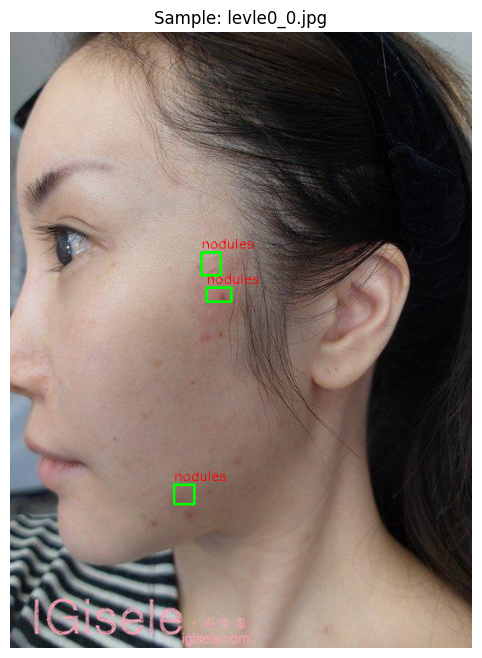

In [11]:
import json
import cv2
import matplotlib.pyplot as plt
from pathlib import Path

# --- Đường dẫn ---
json_path = Path("coco_dataset.json")
img_dir = Path("COCO_Images")

# --- Đọc file JSON ---
with open(json_path, "r") as f:
    coco_data = json.load(f)

# --- Tạo map ảnh và category ---
id2img = {img["id"]: img for img in coco_data["images"]}
id2cat = {cat["id"]: cat["name"] for cat in coco_data["categories"]}

# --- Chọn 1 ảnh đầu tiên để test ---
sample_ann = coco_data["annotations"][0]
img_id = sample_ann["image_id"]
img_info = id2img[img_id]
img_path = img_dir / img_info["file_name"]

# --- Đọc ảnh ---
img = cv2.imread(str(img_path))
if img is None:
    print(f"❌ Không đọc được ảnh: {img_path}")
else:
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # --- Vẽ tất cả bounding box của ảnh ---
    for ann in coco_data["annotations"]:
        if ann["image_id"] == img_id:
            x, y, w, h = ann["bbox"]
            label = id2cat[ann["category_id"]]
            cv2.rectangle(img, (int(x), int(y)), (int(x+w), int(y+h)), (0, 255, 0), 2)
            cv2.putText(img, label, (int(x), int(y)-5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255,0,0), 1)

    # --- Hiển thị ---
    plt.figure(figsize=(8, 8))
    plt.imshow(img)
    plt.axis("off")
    plt.title(f"Sample: {img_info['file_name']}")
    plt.show()


In [2]:
!pip install tqdm

import json
import shutil
import random
from pathlib import Path
from tqdm import tqdm
from collections import defaultdict

# ====== ĐƯỜNG DẪN ======
coco_json_path = Path("coco_dataset.json")   # file COCO tổng hợp
img_dir = Path("COCO_Images")                # thư mục chứa toàn bộ ảnh
output_root = Path("COCO_Split")             # nơi lưu tập train/val/test
output_root.mkdir(parents=True, exist_ok=True)

# ====== ĐỌC DỮ LIỆU ======
with open(coco_json_path, "r") as f:
    coco_data = json.load(f)

images = coco_data["images"]
annotations = coco_data["annotations"]
categories = coco_data["categories"]

# ====== TẠO BẢN ĐỒ ID -> TÊN CLASS ======
cat_id_to_name = {c["id"]: c["name"].lower() for c in categories}

# ====== BỎ CLASS UNKNOWN ======
valid_cat_ids = [cid for cid, name in cat_id_to_name.items() if name != "unknown"]
annotations = [a for a in annotations if a["category_id"] in valid_cat_ids]

# Lọc lại danh sách ảnh chỉ chứa class hợp lệ
valid_image_ids = {a["image_id"] for a in annotations}
images = [img for img in images if img["id"] in valid_image_ids]

# ====== Gom annotation theo ảnh ======
img_to_anns = defaultdict(list)
for ann in annotations:
    img_to_anns[ann["image_id"]].append(ann)

# ====== Gom class theo ảnh ======
img_to_classes = {
    img["id"]: list({cat_id_to_name[ann["category_id"]] for ann in img_to_anns[img["id"]]})
    for img in images
}

# ====== DANH SÁCH CLASS SAU KHI LỌC ======
all_classes = sorted({name for name in cat_id_to_name.values() if name != "unknown"})
print("🎯 Các class còn lại:", all_classes)

# ====== ĐẢM BẢO MỖI SPLIT ĐỀU CÓ ĐỦ CLASS ======
# Ta sẽ chia theo cách “stratified”: mỗi class phân bố vào 3 tập
random.seed(42)
class_to_imgs = defaultdict(list)
for img in images:
    for cls in img_to_classes[img["id"]]:
        class_to_imgs[cls].append(img)

train_ids, val_ids, test_ids = set(), set(), set()

for cls, img_list in class_to_imgs.items():
    random.shuffle(img_list)
    n = len(img_list)
    n_train = int(0.8 * n)
    n_val = int(0.1 * n)
    
    train_ids.update(img["id"] for img in img_list[:n_train])
    val_ids.update(img["id"] for img in img_list[n_train:n_train + n_val])
    test_ids.update(img["id"] for img in img_list[n_train + n_val:])

# ====== Loại trùng để mỗi ảnh chỉ thuộc 1 tập ======
def resolve_conflict(primary, *others):
    for other in others:
        primary -= other

resolve_conflict(val_ids, train_ids)
resolve_conflict(test_ids, train_ids, val_ids)

# ====== TẠO CÁC SPLIT ======
splits = {
    "train": [img for img in images if img["id"] in train_ids],
    "val": [img for img in images if img["id"] in val_ids],
    "test": [img for img in images if img["id"] in test_ids],
}

# ====== LƯU DỮ LIỆU ======
for split_name, split_imgs in splits.items():
    split_dir = output_root / split_name
    split_dir.mkdir(parents=True, exist_ok=True)

    split_img_ids = {img["id"] for img in split_imgs}
    split_annots = [a for a in annotations if a["image_id"] in split_img_ids]

    # Copy ảnh
    print(f"\n📸 Copying images for {split_name} ({len(split_imgs)} images)...")
    for img_info in tqdm(split_imgs):
        src = img_dir / img_info["file_name"]
        dst = split_dir / img_info["file_name"]
        if src.exists():
            shutil.copy2(src, dst)

    # Ghi file JSON riêng
    split_json = {
        "images": split_imgs,
        "annotations": split_annots,
        "categories": [c for c in categories if c["id"] in valid_cat_ids]
    }

    with open(split_dir / f"instances_{split_name}.json", "w") as f:
        json.dump(split_json, f, indent=2)

    print(f"✅ {split_name} done: {len(split_imgs)} images, {len(split_annots)} annotations")

print("\n🎉 Hoàn tất chia dữ liệu train/val/test (đảm bảo đủ class và bỏ unknown)!")
print(f"📁 Dữ liệu được lưu trong: {output_root.resolve()}")


🎯 Các class còn lại: ['acne-types', 'comedones', 'nodules', 'papules']

📸 Copying images for train (8338 images)...


100%|██████████| 8338/8338 [00:10<00:00, 825.63it/s]


✅ train done: 8338 images, 155416 annotations

📸 Copying images for val (431 images)...


100%|██████████| 431/431 [00:00<00:00, 980.23it/s]


✅ val done: 431 images, 2577 annotations

📸 Copying images for test (375 images)...


100%|██████████| 375/375 [00:00<00:00, 975.02it/s] 


✅ test done: 375 images, 1200 annotations

🎉 Hoàn tất chia dữ liệu train/val/test (đảm bảo đủ class và bỏ unknown)!
📁 Dữ liệu được lưu trong: C:\Users\Phong\Downloads\Data\COCO_Split


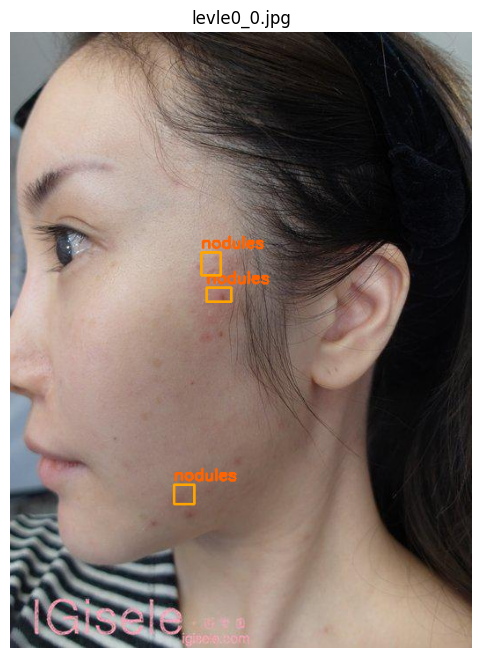

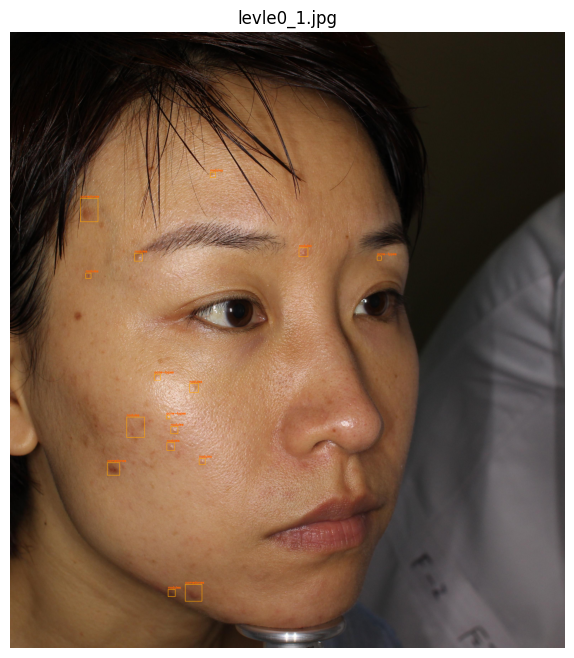

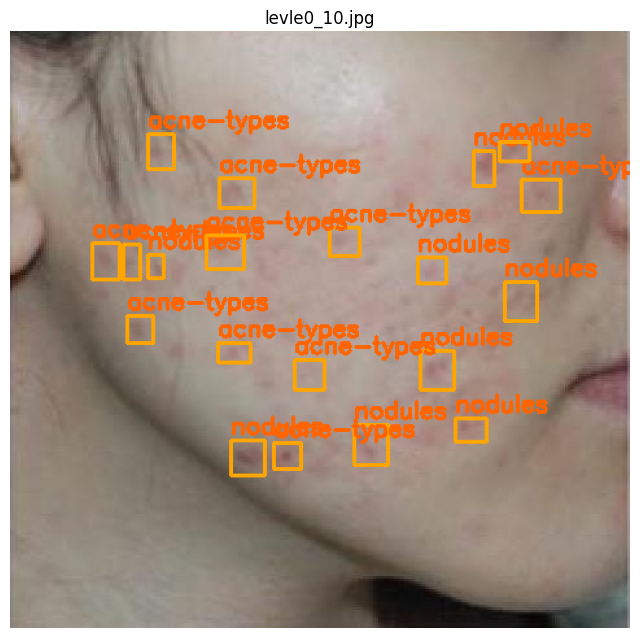

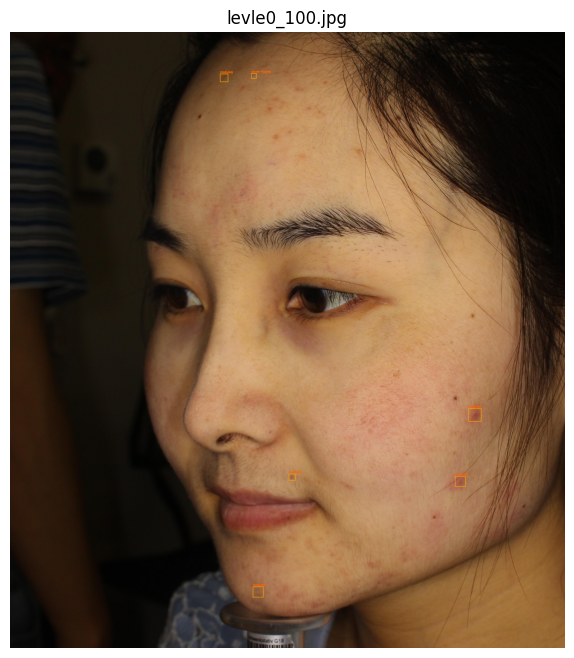

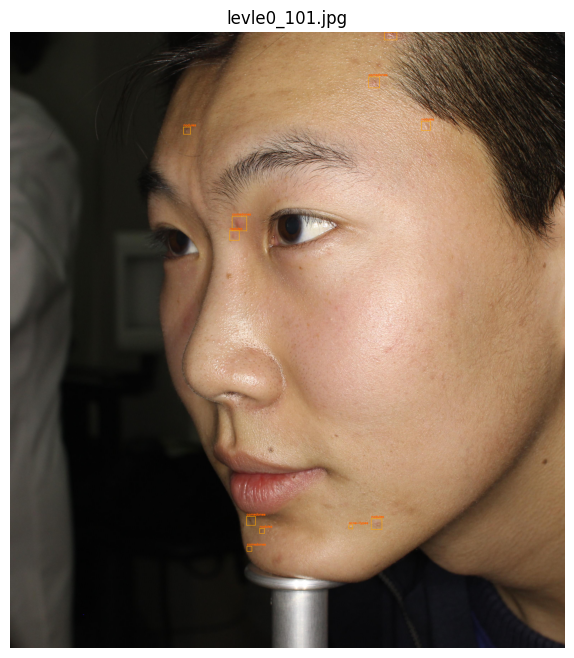

...

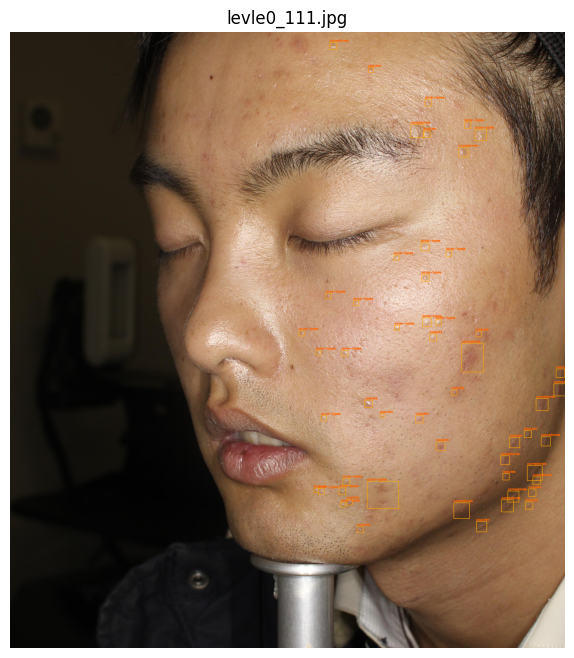

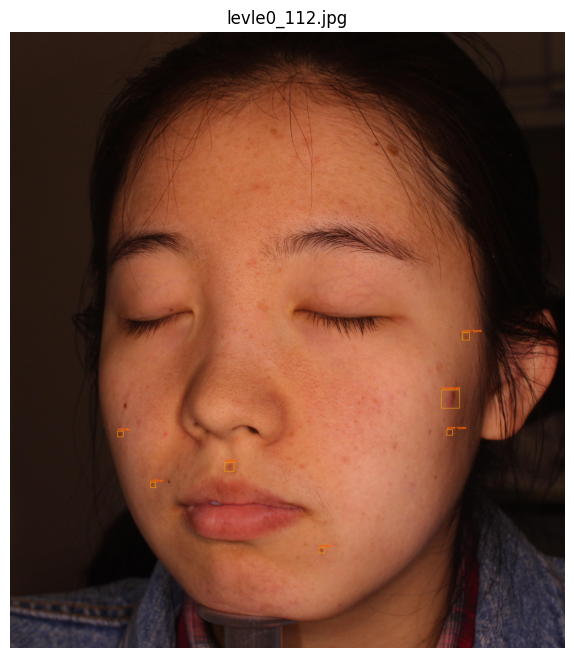

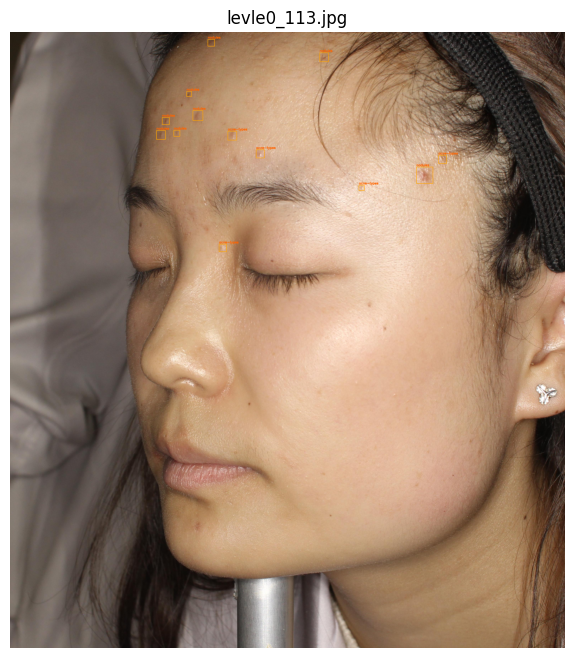

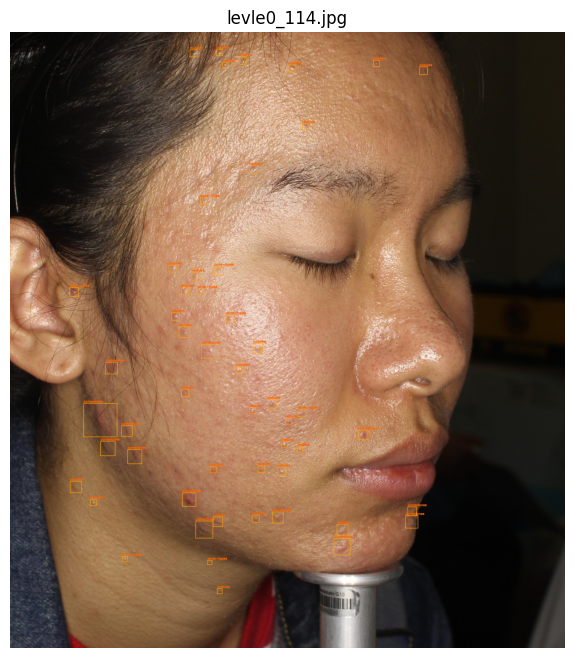

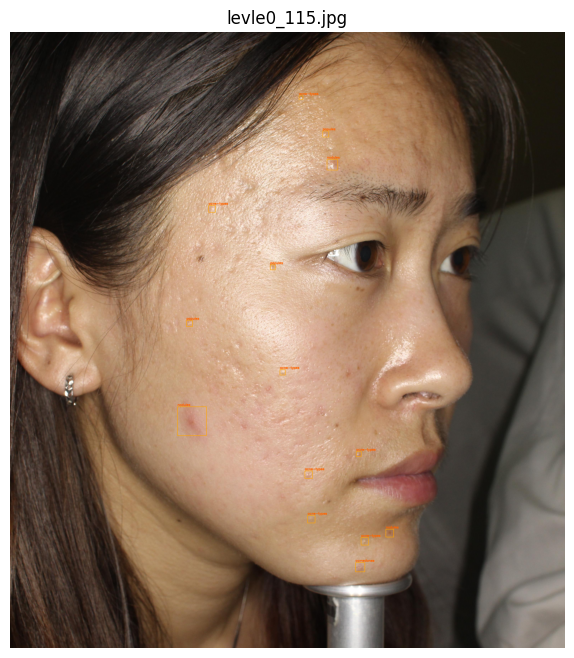

In [6]:
from pathlib import Path
import cv2
import xmltodict
import matplotlib.pyplot as plt

image_dir = Path("Augmented/JPEGImages")  # ảnh gốc
merged_dir = Path("Last/Predicted_XML")                # nhãn đã gộp

# 🧾 Lấy danh sách file XML
xml_files = sorted(list(merged_dir.glob("*.xml")))

# --- Hàm đọc box từ XML ---
def read_boxes(xml_path):
    boxes = []
    with open(xml_path, 'r') as f:
        anno = xmltodict.parse(f.read()).get("annotation", {})
    objects = anno.get("object", [])
    if not isinstance(objects, list):
        objects = [objects]
    for obj in objects:
        try:
            name = obj["name"]
            box = obj["bndbox"]
            x1, y1, x2, y2 = map(int, [box["xmin"], box["ymin"], box["xmax"], box["ymax"]])
            boxes.append((name, x1, y1, x2, y2))
        except:
            continue
    return boxes

# --- Hàm hiển thị ảnh ---
def visualize_merged(img_name):
    img_path = image_dir / img_name
    xml_path = merged_dir / f"{Path(img_name).stem}.xml"

    img = cv2.imread(str(img_path))
    if img is None:
        print(f"⚠️ Không tìm thấy ảnh: {img_path}")
        return
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # 🟧 Vẽ bounding boxes từ merged xml
    for name, x1, y1, x2, y2 in read_boxes(xml_path):
        cv2.rectangle(img, (x1, y1), (x2, y2), (255, 165, 0), 2)  # màu cam
        cv2.putText(img, name, (x1, y1 - 5),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 100, 0), 2)

    # Hiển thị ảnh
    plt.figure(figsize=(8, 8))
    plt.imshow(img)
    plt.title(img_name)
    plt.axis("off")
    plt.show()

# 🖼️ Hiển thị 5 ảnh đầu tiên
for xml in xml_files[:20]:
    img_name = xml.stem + ".jpg"
    visualize_merged(img_name)
